# `EQ` demo
In this IPython notebook, we demonstrate 4 kinds of `EQ` adopted from [audiomentation](https://github.com/iver56/audiomentations):
 
1. Transform based on time domain and [ButterworthFilter](https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.butter.html): `LowPassFilter`, `HighPassFilter`, `BandPassFilter`, `BandStopFilter`.
2. Transform based on time domain and [Biquad Filter Formulae](https://www.w3.org/TR/audio-eq-cookbook/): `PeakingFilter`, `NotchFilter`, `LowShelfFilter`, `HighShelfFilter`.
3. Transform based on freq domain: `AirAbsorption`, `SpecFrequencyMask`.
4. Combination of a few filters: `GraphicEQ10`. 
 
Below is a list of the examples (run all cells as some may depend on previous imports and results). 

In [1]:
import numpy as np
import scipy
import librosa
import soundfile as sf
from IPython.display import display, Audio
import matplotlib.pyplot as plt
plt.style.use('ggplot')

from utils import Drawspec
from EQ import (
    LowPassFilter, HighPassFilter,
    BandPassFilter, BandStopFilter,
    PeakingFilter, NotchFilter, 
    LowShelfFilter, HighShelfFilter,
    AirAbsorption, SpecFrequencyMask, 
    )

# example-signal
PATH = r'D:\workplace\NCA\SSL\sig1\blind_data\0c0220ab-17a1-484b-9a7e-e8410a92f008.wav'
s, fs = librosa.load(PATH,sr=None) 

In [2]:
transforms = [
    {"instance": LowPassFilter(),},
    {"instance": HighPassFilter(),},
    {"instance": BandPassFilter(),},
    {"instance": BandStopFilter(),},
    {"instance": PeakingFilter(),},
    {"instance": NotchFilter(),},
    {"instance": LowShelfFilter(),},
    {"instance": HighShelfFilter(),},
    {"instance": AirAbsorption(),},
    {"instance": SpecFrequencyMask(),}
    ]

dst_root = './examples/'

signals = [s,]
titles = ['Origin',]

for transform in transforms:
    augmenter = transform["instance"]
    run_name = augmenter.__class__.__name__
    titles.append(run_name)
    audio = augmenter(s, fs)
    print(run_name, augmenter.serialize_parameters())
    signals.append(audio)
    sf.write(dst_root+run_name+'.wav', audio.reshape(-1), fs)

LowPassFilter {'rolloff': 24, 'cutoff_freq': 5561.590017600401}
HighPassFilter {'rolloff': 12, 'cutoff_freq': 427.28736761376325}
BandPassFilter {'rolloff': 18, 'center_freq': 3619.364531139678, 'bandwidth': 3656.2642023340786}
BandStopFilter {'rolloff': 18, 'center_freq': 1090.8633372760173, 'bandwidth': 652.0461442671284}
PeakingFilter {'center_freq': 410.6748961154528, 'gain_db': 2.9227107478822845, 'q_factor': 4.230502526383328}
NotchFilter {'center_freq': 3310.9067717637968, 'q_factor': 4.4028810381784425}
LowShelfFilter {'center_freq': 4594.9495735370265, 'gain_db': 16.033530655391445, 'q_factor': 0.8660216351144001}
HighShelfFilter {'center_freq': 952.7816278514879, 'gain_db': 10.095984990866473, 'q_factor': 0.8311187149316656}
AirAbsorption {'temperature': 20, 'humidity': 84, 'distance': 78.6823222611511}
SpecFrequencyMask {'start_frequency_index': 21874, 'end_frequency_index': 47346}


In [3]:
run_name = "GraphicEQ10"
notch_filters_params = [31.0, 62.0, 125.0, 250.0, 500.0, 1000.0, 2000.0, 4000.0, 8000.0, 16000.0]
notch_filters = [NotchFilter(min_center_freq = F, max_center_freq = F) for F in notch_filters_params]
audio = s

for i in range(len(notch_filters)):
    audio = notch_filters[i](audio, fs)
    print(notch_filters[i].serialize_parameters())
    
signals.append(audio)
titles.append(run_name)
sf.write(dst_root+run_name+'.wav', audio.reshape(-1), fs)

{'center_freq': 30.999999999999982, 'q_factor': 3.0148960417809665}
{'center_freq': 61.999999999999964, 'q_factor': 2.3012389532847437}
{'center_freq': 125.00000000000003, 'q_factor': 2.736835934618549}
{'center_freq': 250.00000000000006, 'q_factor': 3.60526150489393}
{'center_freq': 500.0000000000001, 'q_factor': 1.7301101889530148}
{'center_freq': 1000.0000000000002, 'q_factor': 1.5435379015093895}
{'center_freq': 1999.9999999999998, 'q_factor': 4.020098104106944}
{'center_freq': 3999.9999999999995, 'q_factor': 4.30484445530384}
{'center_freq': 8000.000000000002, 'q_factor': 3.9842033963673815}
{'center_freq': 15999.999999999998, 'q_factor': 4.418337915857157}


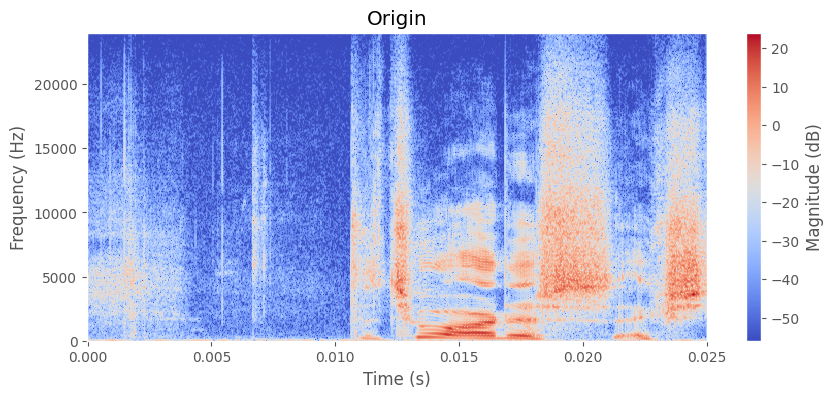

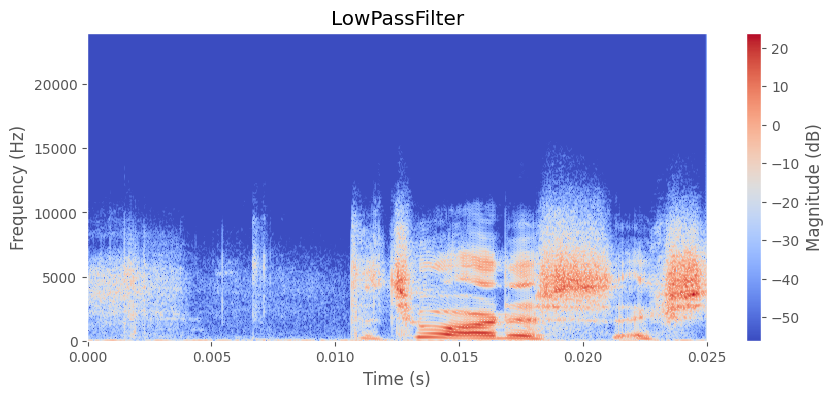

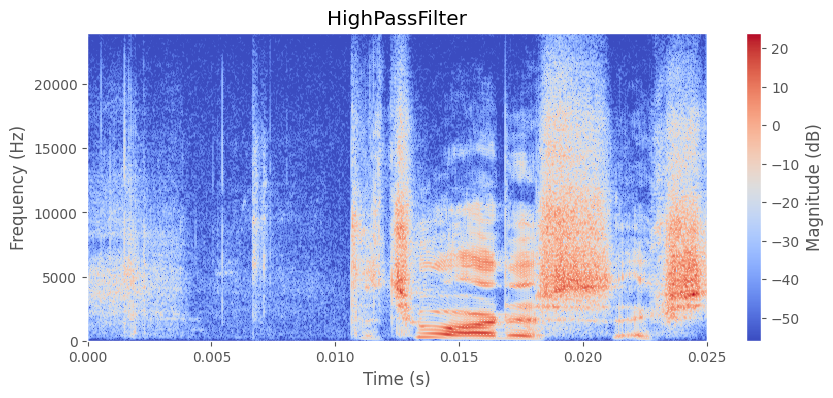

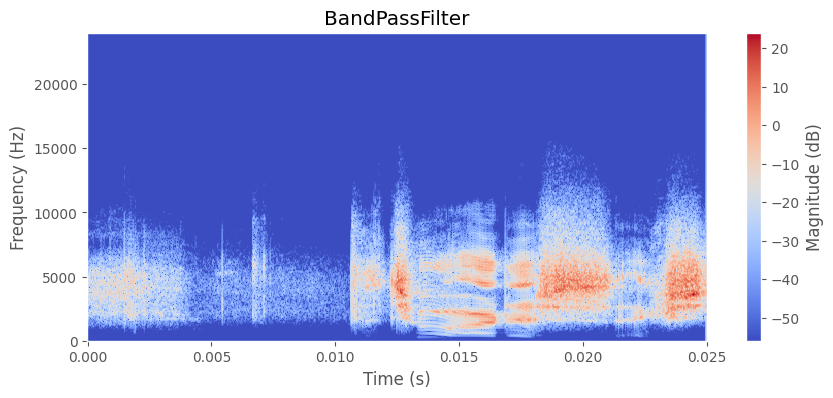

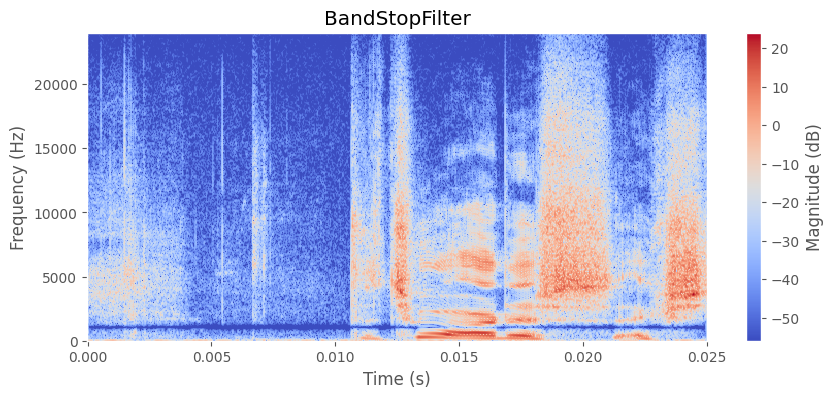

...

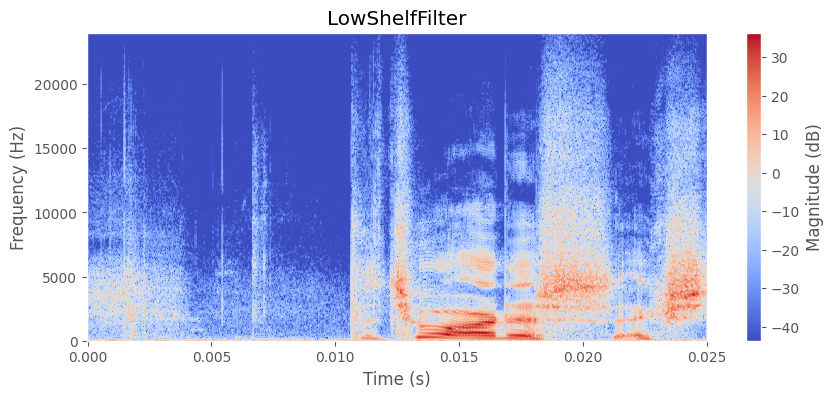

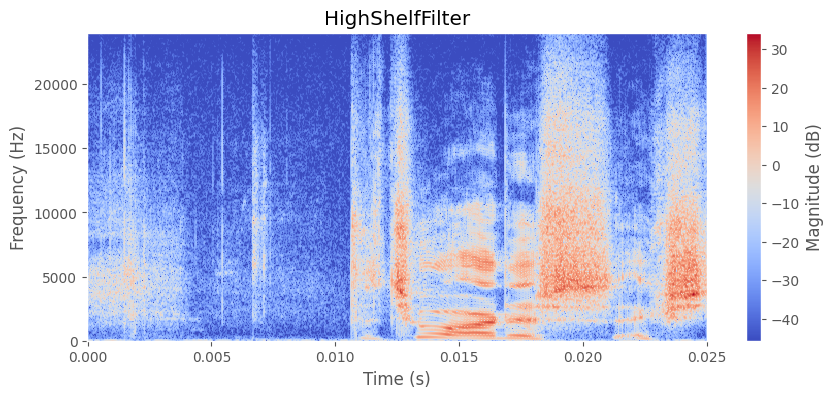

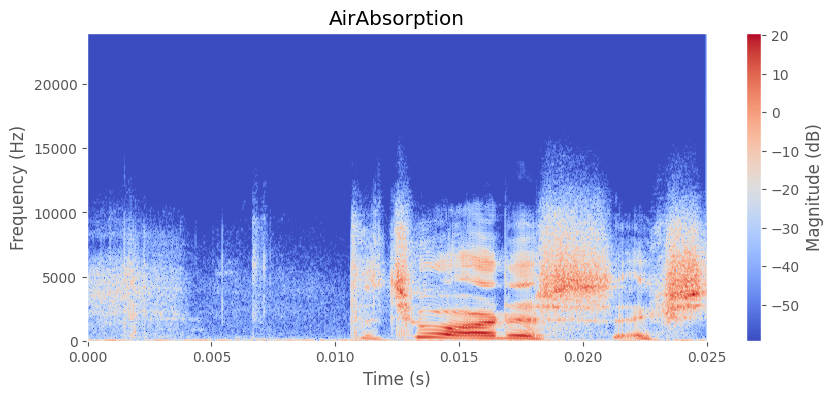

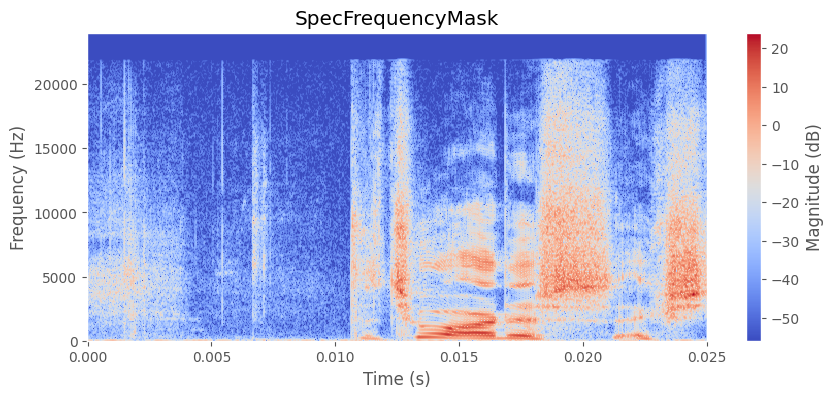

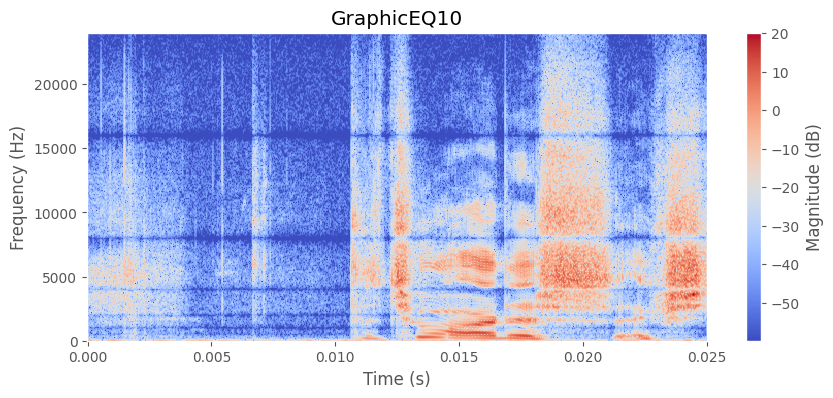

In [4]:
def plot_audio_spectrogram(titles, signals, fs):
    
    for title, signal in zip(titles, signals):
        display(Audio(signal, rate=fs))
        Drawspec(signal[:fs*2], rate=fs, name=title)
        
plot_audio_spectrogram(titles, signals, fs)

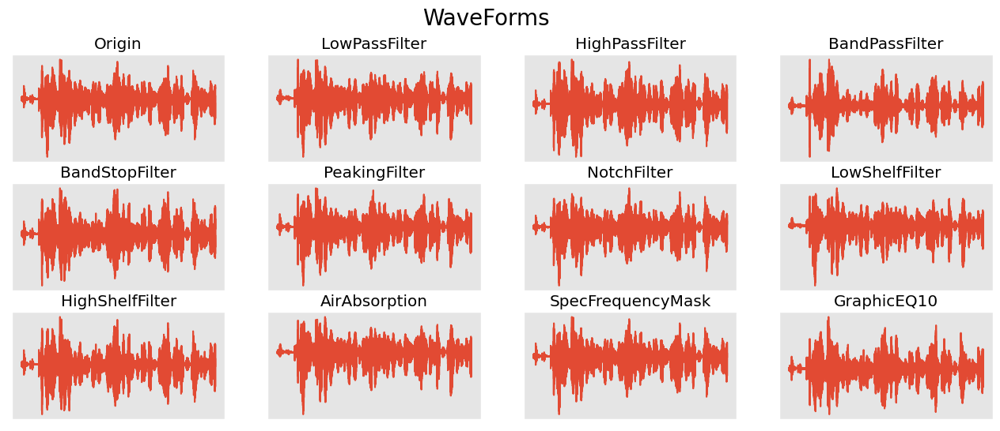

In [5]:
def plot_signals_time(titles, signals, title, shape=(16, 6)):
    
    nrows, ncols = 3, 4
    fig, ax = plt.subplots(nrows, ncols, figsize=shape)
    fig.suptitle(title, size=20)
    
    z = 0
    for i in range(nrows):
        for y in range(ncols):
            ax[i,y].set_title(titles[z])
            ax[i,y].plot(signals[z])
            ax[i,y].set_xticks([])
            ax[i,y].set_yticks([])
            ax[i,y].grid(False)
            z += 1
    
    plt.show()
    
plot_signals_time(titles, signals, title= 'WaveForms')